In [1]:
library(ape)
library(phytools)
library(xlsx)
library(RColorBrewer)
library(phangorn)

Loading required package: maps


In [2]:
set.seed(27042012)

In [3]:
I=read.xlsx("Whealbi_500samples_table.curated.xlsx",1)
head(I)

Whealbi.serial.number,Taxonomy,Taxonomy1,Taxonomy2,Genome,Variety.Genotype,Acession.number,Other.number,Replication,Plant,⋯,NA..972,NA..973,NA..974,NA..975,NA..976,NA..977,NA..978,NA..979,NA..980,NA..981
WW-246,Aegilops,tauschii Coss.,subsp. Tauschii,D,NA,IG 46803,NA,NA,2,⋯,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
WW-247,Aegilops,tauschii Coss.,subsp. tauschii,D,NA,IG 48508,NA,NA,1,⋯,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
WW-248,Aegilops,tauschii Coss.,subsp. strangulata (Eig) Tzvel.,D,NA,AE 525,NA,NA,2,⋯,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
WW-249,Triticum,urartu Thum. ex Gandil.,NA,Au,NA,ID 388 EP047-1,NA,NA,2,⋯,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
WW-250,Triticum,urartu Thum. ex Gandil.,NA,Au,NA,ID 393 EP048-1,NA,NA,3,⋯,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
WW-251,Triticum,urartu Thum. ex Gandil.,NA,Au,NA,ID 1396 EP036-EP037,NA,NA,1,⋯,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA


In [4]:
XX=c("Triticum_monococcum","Triticum_boeoticum","Triticum_urartu",
    "Aegilops_speltoides",
    "Aegilops_tauschii",
    "Triticum_araraticum",
    "Triticum_timopheevii",
    "Triticum_zhukovskyi",
    "Triticum_dicoccoides",
    "Triticum_dicoccon",
    "Triticum_durum",
    "Triticum_turgidum",
    "Triticum_aestivum",
    "Triticum_spelta",
    "Triticum_sphaerococcum"
    )
I$species=factor(paste(gsub(" ","",I$Taxonomy),gsub("(\\S+)\\s+.*","\\1",gsub("^\\s+","",I$Taxonomy1)),sep="_"),levels=XX)

In [5]:
table(I$species,I$Genome)

                        
                          Ab  Am  Au  BA BAD   D  GA GAA  Ss
  Triticum_monococcum      0   3   0   0   0   0   0   0   0
  Triticum_boeoticum       2   0   0   0   0   0   0   0   0
  Triticum_urartu          0   0   3   0   0   0   0   0   0
  Aegilops_speltoides      0   0   0   0   0   0   0   0   4
  Aegilops_tauschii        0   0   0   0   0   3   0   0   0
  Triticum_araraticum      0   0   0   0   0   0  11   0   0
  Triticum_timopheevii     0   0   0   0   0   0   3   0   0
  Triticum_zhukovskyi      0   0   0   0   0   0   0   1   0
  Triticum_dicoccoides     0   0   0   6   0   0   0   0   0
  Triticum_dicoccon        0   0   0   7   0   0   0   0   0
  Triticum_durum           0   0   0  20   0   0   0   0   0
  Triticum_turgidum        0   0   0   3   0   0   0   0   0
  Triticum_aestivum        0   0   0   0 431   0   0   0   0
  Triticum_spelta          0   0   0   0   2   0   0   0   0
  Triticum_sphaerococcum   0   0   0   0   1   0   0   0   0

In [6]:
I$taxon=paste(I$species,I$Whealbi.serial.number,sep=".")

In [7]:
I$Genome=factor(gsub("[^A-z]","",I$Genome),levels=c("Ab","Am","Au","Ss","D","BA","GA","GAA","BAD"))
levels(I$Genome)

[1] "Ab"  "Am"  "Au"  "Ss"  "D"   "BA"  "GA"  "GAA" "BAD"

In [8]:
table(I$Genome)


 Ab  Am  Au  Ss   D  BA  GA GAA BAD 
  2   3   3   4   3  36  14   1 434 

In [ ]:
q=c("WW-455","")

In [10]:
C=read.xlsx("RRHS_RAxML/PhylogeneticClusters.curated.xlsx",1)
head(C)

id,name,taxon,X__glayCluster,TaxonCluster,code
WW-001,Triticum_aestivum.WW-001,Triticum_aestivum,3,Triticum_aestivum_γ,FRA
WW-002,Triticum_aestivum.WW-002,Triticum_aestivum,3,Triticum_aestivum_γ,FRA
WW-003,Triticum_aestivum.WW-003,Triticum_aestivum,3,Triticum_aestivum_γ,FRA
WW-004,Triticum_aestivum.WW-004,Triticum_aestivum,3,Triticum_aestivum_γ,FRA
WW-005,Triticum_aestivum.WW-005,Triticum_aestivum,3,Triticum_aestivum_γ,FRA
WW-006,Triticum_aestivum.WW-006,Triticum_aestivum,3,Triticum_aestivum_γ,FRA


In [11]:
plotTREE=function(tree) {
    options(repr.plot.width=9, repr.plot.height=70)

    #char=I$Genome[match(tree$tip.label,I$taxon)]
    char=C$TaxonCluster[match(tree$tip.label,C$name)]
    char2=I$Biological.status[match(tree$tip.label,I$taxon)]

    colourCount = length(levels(char))
    getPalette = colorRampPalette(brewer.pal(9, "Paired"))
    tree$tip.label=paste(tree$tip.label, char2)
    plot(tree,tip.color=getPalette(colourCount)[char])
}

In [12]:
table(I$Genome)


 Ab  Am  Au  Ss   D  BA  GA GAA BAD 
  2   3   3   4   3  36  14   1 434 

In [13]:
plotDensi=function(filename,tree,drops=NULL) {
    options(repr.plot.width=15, repr.plot.height=70)

    trees=NULL
    trees=read.tree(filename)
    trees=lapply(trees,function(x){
        if (! is.null(drops)) {x=drop.tip(x,drops);}
        x$tip.label=I$taxon[match(x$tip.label,I$Whealbi.serial.number)]
        x
    })
    class(trees) <- "multiPhylo"
    is_tip = tree$edge[,2] <= length(tree$tip.label)
    ordered_tips = tree$tip.label[tree$edge[is_tip, 2]]
    getPalette = colorRampPalette(brewer.pal(9, "Paired"))
    qq=C$TaxonCluster[match(ordered_tips,C$name)]
    cols=getPalette(length(levels(qq)))[qq]
    densiTree(trees,alpha=0.01,consensus=ordered_tips,tip.color=cols)
    return(trees)
}

## ASTRAL coalescence

In [14]:
astral.A=read.tree("RRHS_RAxML/RAxML_bestTree.ASC_GTRGAMMA_felsenstein.A.astral.nh")

In [15]:
astral.A$tip.label=I$taxon[match(astral.A$tip.label,I$Whealbi.serial.number)]

In [16]:
node=getMRCA(astral.A,astral.A$tip.label[grep("Triticum_urartu|Triticum_monococcum",astral.A$tip.label)])
node

[1] 813

In [17]:
astral.A=root(astral.A,node=node)

In [18]:
summary(astral.A$edge.length)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max.    NA's 
 0.0000  0.3025  0.7836  2.1155  3.6350  6.5033     482 

In [19]:
astral.A$edge.length[is.na(astral.A$edge.length)]=0

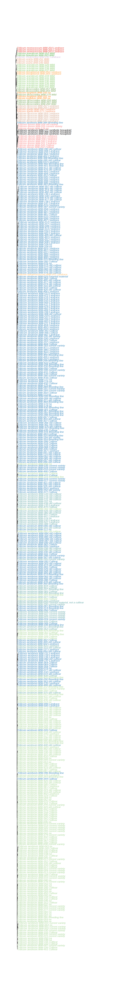

In [20]:
plotTREE(astral.A)

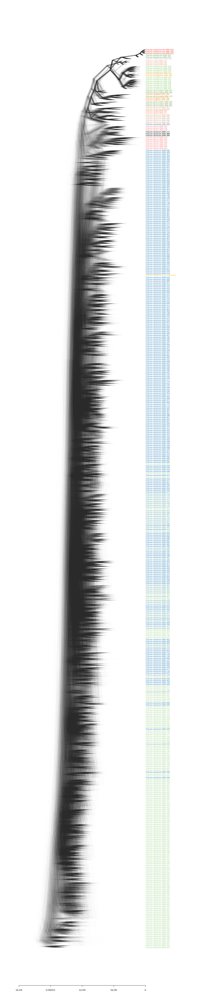

In [21]:
RRHS.A=plotDensi("RRHS_RAxML/RAxML_bestTree.ASC_GTRGAMMA_felsenstein.A.1000.boot",astral.A)

In [22]:
astral.B=read.tree("RRHS_RAxML/RAxML_bestTree.ASC_GTRGAMMA_felsenstein.B.astral.nh")

In [23]:
astral.B$tip.label=I$taxon[match(astral.B$tip.label,I$Whealbi.serial.number)]

In [24]:
node=getMRCA(astral.B,astral.B$tip.label[grep("Aegilops_speltoides",astral.B$tip.label)])
node

[1] 919

In [25]:
astral.B=root(astral.B,node=node)

In [26]:
summary(astral.B$edge.length)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max.    NA's 
 0.0000  0.2880  0.6154  1.7625  2.3725  6.5033     462 

In [27]:
astral.B$edge.length[is.na(astral.B$edge.length)]=0

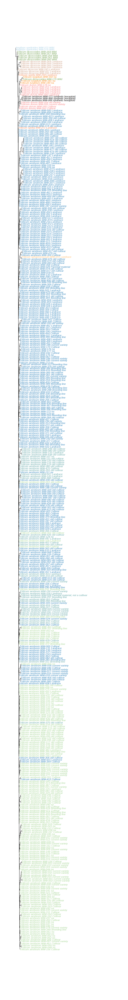

In [28]:
plotTREE(astral.B)

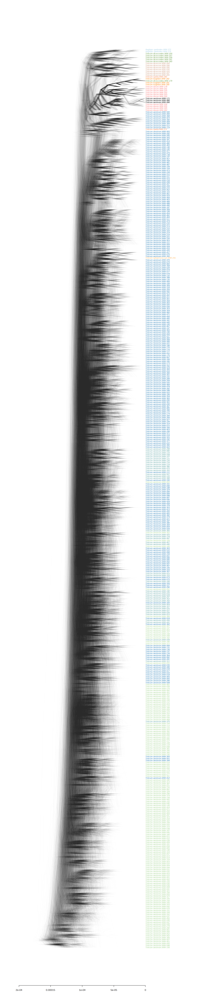

In [29]:
RRHS.B=plotDensi("RRHS_RAxML/RAxML_bestTree.ASC_GTRGAMMA_felsenstein.B.1000.boot",astral.B)

In [30]:
astral.D=read.tree("RRHS_RAxML/RAxML_bestTree.ASC_GTRGAMMA_felsenstein.D.astral.nh")

In [31]:
astral.D$tip.label=I$taxon[match(astral.D$tip.label,I$Whealbi.serial.number)]

In [32]:
node=getMRCA(astral.D,astral.D$tip.label[grep("Aegilops_tauschii",astral.D$tip.label)])
node

[1] 750

In [33]:
astral.D=root(astral.D,node=node)

In [34]:
summary(astral.D$edge.length)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max.    NA's 
 0.0000  0.0685  0.1801  0.6765  0.5438  6.5033     438 

In [35]:
astral.D$edge.length[is.na(astral.D$edge.length)]=0

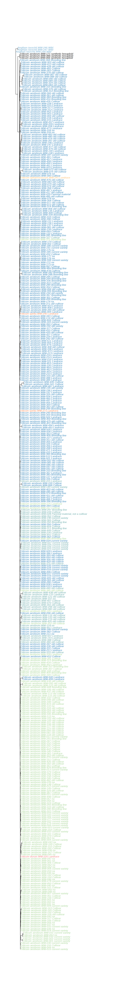

In [36]:
plotTREE(astral.D)

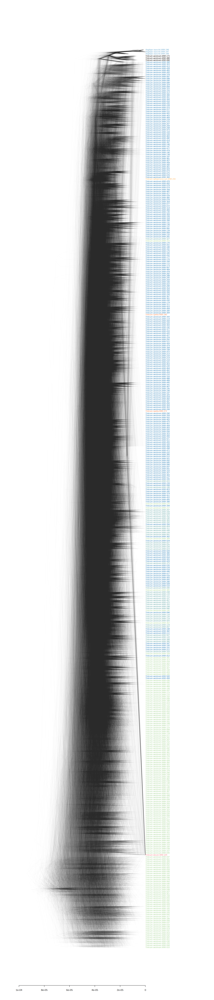

In [37]:
RRHS.D=plotDensi("RRHS_RAxML/RAxML_bestTree.ASC_GTRGAMMA_felsenstein.D.1000.boot",astral.D)